# Data Collection Report

## Amazon Listings
Are taken from https://www.kaggle.com/datasets/mysarahmadbhat/airbnb-listings-reviews.
Need to use 'latin1' encoding for successful creation of pandas dataframe.

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import plotly.express as px

%matplotlib inline

In [2]:
dtypes = dict(
    listing_id=np.int32,
    name='str',
    host_id=np.int32,
    host_location=str,
    host_response_time=str,
    host_response_rate=np.float32,
    host_acceptance_rate=np.float32,
)
df = pd.read_csv('data/Listings.csv', encoding='latin1', dtype=dtypes)
df.host_since = pd.to_datetime(df.host_since, infer_datetime_format=True)

/home/ummagumma/miniconda3/envs/vtkenv/lib/python3.6/site-packages/IPython/core/interactiveshell.py:2714: DtypeWarning:

Columns (13) have mixed types. Specify dtype option on import or set low_memory=False.



In [3]:
print(f"{df.memory_usage(deep=True).sum() / 2**20} Mb")

341.90801429748535 Mb


# Data description
The dataset contains 33 columns with 
* listing-host pairings 
* client review scores 
* basic information about the listing
* basic informantion about host's profile
* price
* listing's location - coordinates, city, district, neighbourhood, country
* amenities

There are 3 string columns:
* Listing's name
* Host's location
* Neighbourhood
* District
* City
* property_type	
* room_type

# Reviews
There is a single 'review_\*' for each listing, but there definitely were more reviews. Is it a mean/max/what?

All values are near the 10 value, the maximum one. I don't believe that all listings are good and there never were problems. Plus, ~1/3 of values are missing. Plus, these numerical columns cannot tell what are the problems with a listing, and 'reviews.csv' is empty, I will not have any material to explain to stakeholders what to focus on. Moreover, I cannot even set a reliable target column. 

# Listing info
Client dissatisfaction comes mainly after the trip, not before. For example, they could have seen good photos on a web-page, but then it turned out to be a trash place -> client is dissatisfied. Without such information, it's inadequate to try to try to find something.

# Price

For price I need to find:
* The date when it was set, so I know which currency conversion value to take.
* Correspondence between a country and a price
* Mean income of people in this country, so I can judge about how adequate the price is
* Mean price for a listing in this country/city/district/etc...
* Mean expences on visiting this city (for a day, few days, a week, etc.)
* Price in itself is not enough to predict client satisfaction. Price/quality is a more reasonable feature, but I need to infer the quality of the listing in some way.

For most of the points above, there are no information in the dataset. So I'll need to find other ones.


# Looking for another dataset

Okay, so I considered this dataset as a crap, and found another one:
http://insideairbnb.com/get-the-data/

I can easily collect info for the same cities from there, but with much greater details: everything in here + pictures, reviews, geodata, and calendar events. Bye!

In [4]:
df.columns

Index(['listing_id', 'name', 'host_id', 'host_since', 'host_location',
       'host_response_time', 'host_response_rate', 'host_acceptance_rate',
       'host_is_superhost', 'host_total_listings_count',
       'host_has_profile_pic', 'host_identity_verified', 'neighbourhood',
       'district', 'city', 'latitude', 'longitude', 'property_type',
       'room_type', 'accommodates', 'bedrooms', 'amenities', 'price',
       'minimum_nights', 'maximum_nights', 'review_scores_rating',
       'review_scores_accuracy', 'review_scores_cleanliness',
       'review_scores_checkin', 'review_scores_communication',
       'review_scores_location', 'review_scores_value', 'instant_bookable'],
      dtype='object')

In [5]:
df.district.unique()

array([nan, 'Manhattan', 'Brooklyn', 'Queens', 'Bronx', 'Staten Island'],
      dtype=object)

In [35]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 279712 entries, 0 to 279711
Data columns (total 33 columns):
listing_id                     279712 non-null int32
name                           279539 non-null object
host_id                        279712 non-null int32
host_since                     279547 non-null datetime64[ns]
host_location                  278872 non-null object
host_response_time             150930 non-null object
host_response_rate             150930 non-null float32
host_acceptance_rate           166625 non-null float32
host_is_superhost              279547 non-null object
host_total_listings_count      279547 non-null float64
host_has_profile_pic           279547 non-null object
host_identity_verified         279547 non-null object
neighbourhood                  279712 non-null object
district                       37012 non-null object
city                           279712 non-null object
latitude                       279712 non-null float64
longitude       

In [7]:
df.describe()

,listing_id,host_id,host_response_rate,host_acceptance_rate,host_total_listings_count,latitude,longitude,accommodates,bedrooms,price,minimum_nights,maximum_nights,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value
count,2.797120e+05,2.797120e+05,150930.000000,166625.000000,279547.000000,279712.000000,279712.000000,279712.000000,250277.000000,279712.000000,279712.000000,2.797120e+05,188307.000000,187999.000000,188047.000000,187941.000000,188025.000000,187937.000000,187927.000000
mean,2.638196e+07,1.081658e+08,0.865939,0.827168,24.581612,18.761862,12.595075,3.288736,1.515509,608.792737,8.050967,2.755860e+04,93.405195,9.565476,9.312869,9.701534,9.698593,9.633994,9.335364
std,1.442576e+07,1.108570e+08,0.283744,0.289202,284.041143,32.560343,73.081309,2.133379,1.153080,3441.826611,31.518946,7.282875e+06,10.070437,0.990878,1.146072,0.867434,0.886884,0.833234,1.042625
min,2.577000e+03,1.822000e+03,0.000000,0.000000,0.000000,-34.264400,-99.339630,0.000000,1.000000,0.000000,1.000000,1.000000e+00,20.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000
25%,1.384462e+07,1.720656e+07,0.900000,0.780000,1.000000,-22.964390,-43.198040,2.000000,1.000000,75.000000,1.000000,4.500000e+01,91.000000,9.000000,9.000000,10.000000,10.000000,9.000000,9.000000
50%,2.767098e+07,5.826911e+07,1.000000,0.980000,1.000000,40.710785,2.382780,2.000000,1.000000,150.000000,2.000000,1.125000e+03,96.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000
75%,3.978485e+07,1.832853e+08,1.000000,1.000000,4.000000,41.908610,28.986730,4.000000,2.000000,474.000000,5.000000,1.125000e+03,100.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000
max,4.834353e+07,3.901874e+08,1.000000,1.000000,7235.000000,48.904910,151.339810,16.000000,50.000000,625216.000000,9999.000000,2.147484e+09,100.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000


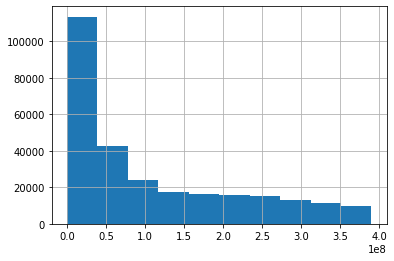

In [8]:
df.host_id.hist()
plt.show()

# Hosts

We have a host_id for every listing

In [9]:
df.host_id.isna().sum()

0

Each host can have several listings

In [10]:
df.groupby(by='host_id').size()

host_id
1822          1
1944         11
2330          3
2353          1
2438          1
2571          1
2626          2
2782          3
2787          8
2827          1
2845          2
2868          1
2881          2
3047          5
3085          1
3280          3
3504          7
3607          2
3631          1
3647          2
3754          1
3757          1
4170          1
4396          2
4869          1
5089          1
6041          1
6792          9
7209          1
7355          2
             ..
389316854     1
389322466     1
389323937     1
389332076     3
389339650     3
389341094     1
389374864     1
389393401     1
389399160     2
389426886     1
389468573     1
389479024     1
389485308     1
389493179     3
389562125     1
389592301     1
389596131     5
389602663     1
389616992     1
389707663     1
389716512     1
389720737     1
389724963     1
389746841     1
389750985     1
389764135     1
389953017     2
390125111     1
390178153     1
390187445     1
Length: 182024, 

There is a field host_total_listings_count, but it doesn't correspond to real amount of listings in the table. For example below, for host 1944 it's written they have 12 listing, but actually only 11 show up.

In [11]:
df[df['host_id'] == 1944]

,listing_id,name,host_id,host_since,host_location,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_total_listings_count,...,minimum_nights,maximum_nights,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable
113711,31647336,Camera arredata zona Stella Polare in apt,1944,2008-08-13,"Rome, Lazio, Italy",within an hour,1.0,1.0,t,12.0,...,7,1125,100.0,10.0,10.0,10.0,10.0,10.0,8.0,t
173203,31959456,Osp. Grassi Guardia di Finanza camera arredata,1944,2008-08-13,"Rome, Lazio, Italy",within an hour,1.0,1.0,t,12.0,...,7,30,100.0,10.0,10.0,10.0,10.0,10.0,10.0,t
173765,12871422,FAO/WFP/ICCROM/IFAD/UNIV.ROMA 3 single room,1944,2008-08-13,"Rome, Lazio, Italy",within an hour,1.0,1.0,t,12.0,...,7,365,100.0,10.0,9.0,10.0,10.0,9.0,9.0,f
182426,12852458,WFP/FAO/ICCROM/IFAD / Univ Roma3 /WFP single ...,1944,2008-08-13,"Rome, Lazio, Italy",within an hour,1.0,1.0,t,12.0,...,15,365,96.0,10.0,10.0,10.0,10.0,8.0,9.0,t
182437,36109705,Guardia di Finanza/Stella Polare camera arredata,1944,2008-08-13,"Rome, Lazio, Italy",within an hour,1.0,1.0,t,12.0,...,7,1110,95.0,10.0,10.0,10.0,10.0,10.0,9.0,t
182505,11509515,WFP-FAO-ICCROM-BIOVERSITY cute private room,1944,2008-08-13,"Rome, Lazio, Italy",within an hour,1.0,1.0,t,12.0,...,15,180,100.0,10.0,10.0,10.0,10.0,10.0,10.0,f
244158,11495251,Circo Massimo hystorical Rome apt sleeps 5 people,1944,2008-08-13,"Rome, Lazio, Italy",within an hour,1.0,1.0,t,12.0,...,3,150,88.0,9.0,9.0,9.0,9.0,10.0,9.0,t
245087,2709850,Cute small apt Rome centre,1944,2008-08-13,"Rome, Lazio, Italy",within an hour,1.0,1.0,t,12.0,...,15,365,NaN,NaN,NaN,NaN,NaN,NaN,NaN,t
245800,12269354,Trastevere station cute miniflat,1944,2008-08-13,"Rome, Lazio, Italy",within an hour,1.0,1.0,t,12.0,...,15,365,82.0,9.0,8.0,10.0,10.0,9.0,8.0,t
246099,11590562,Colosseo/FAO fab wide apt sleeps 4 people,1944,2008-08-13,"Rome, Lazio, Italy",within an hour,1.0,1.0,t,12.0,...,3,180,93.0,9.0,9.0,10.0,10.0,10.0,9.0,t


Also, there are incosistencies in the column 'host_total_listings_count' itself. However, they are rare.

In [12]:
grouped_by_hosts = df.groupby(by='host_id')
htlc = grouped_by_hosts.host_total_listings_count
grouped_by_hosts.size()[(htlc.min() != htlc.max()) & (~htlc.max().isna() | ~htlc.min().isna())]

host_id
27559965       5
91654021     199
159355723      7
175128252    396
310835509      8
344804377     80
dtype: int64

In [13]:
df[df['host_id'] == 27559965]

,listing_id,name,host_id,host_since,host_location,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_total_listings_count,...,minimum_nights,maximum_nights,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable
133584,17560261,Cheap room in the Heart of Mexico,27559965,2015-02-10,"Sydney, New South Wales, Australia",a few days or more,0.0,0.0,f,5.0,...,1,1125,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f
188201,5621303,Room with a Million Dollar View,27559965,2015-02-10,"Sydney, New South Wales, Australia",a few days or more,0.0,0.0,f,6.0,...,1,10,99.0,10.0,9.0,10.0,10.0,10.0,10.0,f
188202,10979999,Your own Room with city view,27559965,2015-02-10,"Sydney, New South Wales, Australia",a few days or more,0.0,0.0,f,6.0,...,1,15,92.0,9.0,8.0,10.0,10.0,10.0,9.0,f
189983,11594299,Comfy Room in Great Area,27559965,2015-02-10,"Sydney, New South Wales, Australia",a few days or more,0.0,0.0,f,6.0,...,2,8,80.0,8.0,9.0,9.0,10.0,9.0,8.0,f
190049,39936013,Sydney relax balcony,27559965,2015-02-10,"Sydney, New South Wales, Australia",a few days or more,0.0,0.0,f,6.0,...,2,15,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f


## Question
Why are there inconsistencies between values in column host_total_listings_count and real amount of host's rows in the table?

In [14]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 279712 entries, 0 to 279711
Data columns (total 33 columns):
listing_id                     279712 non-null int32
name                           279539 non-null object
host_id                        279712 non-null int32
host_since                     279547 non-null datetime64[ns]
host_location                  278872 non-null object
host_response_time             150930 non-null object
host_response_rate             150930 non-null float32
host_acceptance_rate           166625 non-null float32
host_is_superhost              279547 non-null object
host_total_listings_count      279547 non-null float64
host_has_profile_pic           279547 non-null object
host_identity_verified         279547 non-null object
neighbourhood                  279712 non-null object
district                       37012 non-null object
city                           279712 non-null object
latitude                       279712 non-null float64
longitude       

# Name

Almost every listing has a name

In [15]:
df.name.isna().sum() / df.name.size

0.0006184933074018991

The strings are messed up supposedly because of french accents.

In [16]:
df.name.head(5)

0      Beautiful Flat in le Village Montmartre, Paris
1                     39 mÃÂ² Paris (Sacre CÃ
âur)
2                 Lovely apartment with Terrace, 60m2
3                 Cosy studio (close to Eiffel tower)
4    Close to Eiffel Tower - Beautiful flat : 2 rooms
Name: name, dtype: object

In [17]:
df[df.name.isna()].groupby('host_location').size()

host_location
AU                                                  1
Alcorcon, Community of Madrid, Spain                1
Annecy, RhÃÂ´ne-Alpes, France                      1
BR                                                 10
Bang Rak, Bangkok, Thailand                         1
Bangkok                                             2
Bangkok, Thailand                                   6
BeyoÃÅ¸lu, Istanbul, Turkey                        1
BeÃ
Å¸iktaÃ
Å¸, Istanbul Province, Turkey           1
Bondi Beach, New South Wales, Australia             2
Brasil                                              1
CA                                                  1
CN                                                  1
CO                                                  2
FR                                                  2
Fatih, Istanbul Province, Turkey                    1
Fecamp, Normandy, France                            1
GB                                                  1
Hong Kong     

# Host location

There are 7160 unique location names

In [18]:
unique_locations = df.host_location.unique()
unique_locations.size

7160

It seems that all of them have a format "City, Region, Country"

In [19]:
unique_locations

array(['Paris, Ile-de-France, France',
       'New York, New York, United States',
       'Hericy, Ile-de-France, France', ...,
       'Saint-Jean-de-Fos, Occitanie, France',
       'Lindfield, England, United Kingdom',
       'BrasÃ\x83Â\xadlia de Minas, State of Minas Gerais, Brazil'],
      dtype=object)

The same city can be in several forms, so this column may require standartization of names.

In [20]:
list(filter(lambda x: not x is np.nan and 'Rio' in x and 'Brazil' in x, unique_locations.tolist()))[:5]

['Rio de Janeiro, Rio de Janeiro, Brazil',
 'Rio de Janeiro, State of Rio de Janeiro, Brazil',
 'Tijuca, State of Rio de Janeiro, Brazil',
 'Nova Iguacu, State of Rio de Janeiro, Brazil',
 'Rio, Rio de Janeiro, Brazil']

In [21]:
countries = df.host_location.apply(lambda x: x.split(',')[-1].strip() if x is not np.nan else x)

The entries are mainly for around 10 countries, some small number of others included. Also, there is some amount of rubbish country names or something completely irrelevant. 

In [22]:
countries_nums = countries.groupby(countries).size()
countries_nums.sort_values()[::-1]

host_location
France                       53272
United States                32975
Australia                    26982
Italy                        22030
Brazil                       21003
Mexico                       16217
Turkey                       15916
South Africa                 14991
Thailand                     12371
FR                            8296
TR                            6311
US                            4753
IT                            4732
Hong Kong                     4602
AU                            4335
BR                            4293
TH                            3218
ZA                            3010
MX                            2804
United Kingdom                2138
China                         1689
HK                            1349
Istanbul                       784
CN                             647
Germany                        572
Spain                          469
Bangkok                        433
GB                             392
Switze

In [23]:
px.histogram(countries, x='host_location').show()

## Summary 
Standartization of names and rubbish filtering is required.

# Reviews

In [24]:
reviews = df.filter(regex='review_*')
reviews.head(5)

,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value
0,100.0,10.0,10.0,10.0,10.0,10.0,10.0
1,100.0,10.0,10.0,10.0,10.0,10.0,10.0
2,100.0,10.0,10.0,10.0,10.0,10.0,10.0
3,100.0,10.0,10.0,10.0,10.0,10.0,10.0
4,100.0,10.0,10.0,10.0,10.0,10.0,10.0


Approximately 1/3 of people don't put scores on review categories

In [25]:
reviews.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 279712 entries, 0 to 279711
Data columns (total 7 columns):
review_scores_rating           188307 non-null float64
review_scores_accuracy         187999 non-null float64
review_scores_cleanliness      188047 non-null float64
review_scores_checkin          187941 non-null float64
review_scores_communication    188025 non-null float64
review_scores_location         187937 non-null float64
review_scores_value            187927 non-null float64
dtypes: float64(7)
memory usage: 14.9 MB


In [26]:
reviews = reviews[(~reviews.isna()).all(axis=1)]

Most of the visitor put a high score for everything. So the goal may be to study the cases with small scores (or, for example, less than 9). There are ~20% of people who put a score < 9 for at least one category.

In [27]:
reviews.describe()

,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value
count,187831.000000,187831.000000,187831.000000,187831.000000,187831.000000,187831.000000,187831.000000
mean,93.415491,9.566073,9.313606,9.702089,9.699443,9.634240,9.335754
std,10.023246,0.988567,1.143828,0.865301,0.883830,0.832545,1.041508
min,20.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000
25%,91.000000,9.000000,9.000000,10.000000,10.000000,9.000000,9.000000
50%,96.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000
75%,100.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000
max,100.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000


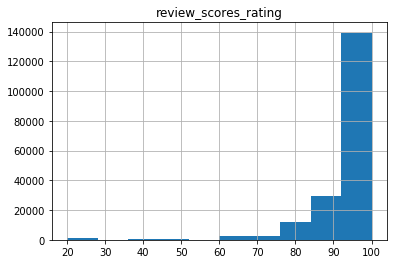

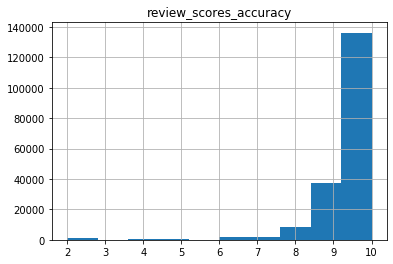

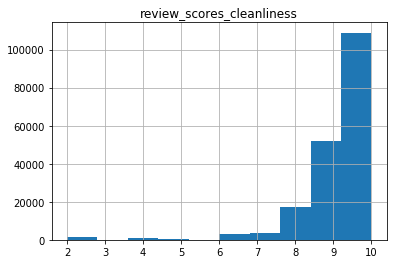

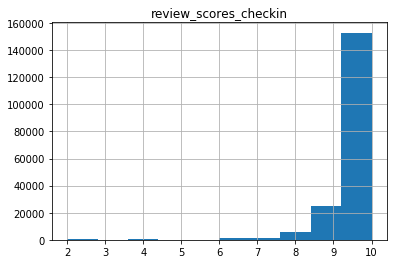

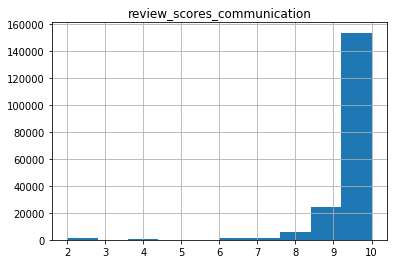

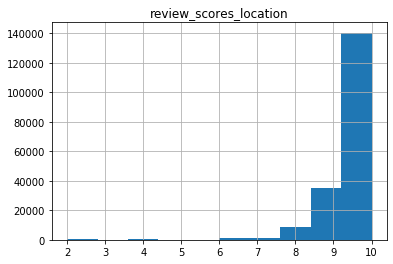

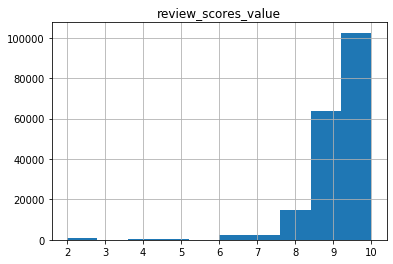

In [28]:
for review_name in reviews.columns:
    reviews[review_name].hist()
    plt.title(review_name)
    plt.show()

In [29]:
(reviews < 9).any(axis=1).sum() / reviews.shape[0]

0.23248026151167805

In [30]:
reviews[(reviews < 9).any(axis=1)].head(5)

,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value
763,90.0,10.0,8.0,10.0,10.0,10.0,10.0
764,92.0,10.0,7.0,10.0,10.0,10.0,10.0
765,90.0,10.0,7.0,10.0,10.0,10.0,10.0
766,87.0,10.0,8.0,10.0,10.0,10.0,10.0
767,90.0,10.0,8.0,10.0,10.0,10.0,10.0


Review columns are correlated with each other. The least correlated column is 'location', but it's still around 0.5.

In [31]:
px.imshow(reviews.corr(), x=reviews.columns, y=reviews.columns, title='Review columns correlation').show()

In [32]:
df_rev = df.copy()
df_rev['has_reviews'] = ~df.filter(regex='review_*').isna().all(axis=1)
description = df_rev.groupby('has_reviews').describe()

In [33]:
px.histogram(df_rev[df_rev.price < 2000], x='price', color='has_reviews',
             marginal='box').show()

The price has a lot of outliers, they may be either a garbage, or a high local currency conversion coeffisient.

In [34]:
df.price.describe()

count    279712.000000
mean        608.792737
std        3441.826611
min           0.000000
25%          75.000000
50%         150.000000
75%         474.000000
max      625216.000000
Name: price, dtype: float64